In [26]:
import gwy
import sys
import numpy as np
sys.path.insert(1, '/usr/share/gwyddion/pygwy/')
import gwyutils
import skimage.io
import matplotlib.pyplot as plt
import matplotlib as mlp
%matplotlib inline
import copy
from PIL import ImageFont
from PIL import Image
from PIL import ImageDraw

In [2]:
data_path ='/home/jorghyq/Project/GwyUtils/test/a14Graphene_Ag024.sxm'
c = gwy.gwy_app_file_load(data_path)
#dfields = gwyutils.get_data_fields_dir(c)
data = c['/6/data']

channel = c['/0/data/title']
print c.keys_by_name()


('/0/meta', '/0/data/log', '/1/data', '/1/data/title', '/1/meta', '/1/data/log', '/2/data', '/2/data/title', '/2/meta', '/2/data/log', '/3/data', '/3/data/title', '/3/meta', '/3/data/log', '/4/data', '/4/data/title', '/4/meta', '/4/data/log', '/5/data', '/5/data/title', '/5/meta', '/5/data/log', '/0/data/title', '/6/data', '/6/data/title', '/6/meta', '/6/data/log', '/7/data', '/7/data/title', '/7/meta', '/7/data/log', '/0/data', '/filename', '/0/data/visible')


In [17]:
f = c['/0/data']
temp = f.get_data()
temp = np.array(temp)
temp.shape

(262144,)

In [4]:
addr = data.get_data()
print addr

(-6.497361660003662, -6.199984550476074, -5.4723801612854, -5.889983177185059, -5.1588335037231445, -5.3868560791015625, -6.205799102783203, -5.311150074005127, -4.3957929611206055, -3.658660411834717, -3.9870810508728027, -4.940387725830078, -4.6143622398376465, -4.9729413986206055, -5.024245262145996, -5.3384904861450195, -5.119851112365723, -3.9789633750915527, -3.7025704383850098, -3.567815065383911, -4.295507431030273, -5.226566791534424, -5.732913017272949, -5.457128047943115, -4.600429058074951, -4.475379943847656, -4.820401668548584, -5.333924770355225, -5.616969585418701, -5.270846843719482, -5.379632949829102, -5.182197570800781, -5.367806434631348, -5.470149993896484, -5.00387716293335, -4.951361656188965, -5.148293495178223, -5.382008075714111, -5.594873905181885, -5.566635608673096, -4.800017833709717, -5.885439395904541, -7.032940864562988, -6.529364109039307, -5.4610209465026855, -5.315518379211426, -5.599593162536621, -5.3236846923828125, -5.408164024353027, -5.56159257

In [15]:
test =np.array(addr)
print test.shape

NameError: name 'addr' is not defined

In [18]:
test=temp.reshape(512,512)
array = test

In [13]:
print np.transpose(test)

[[-6.49736166 -7.11268091 -4.36813641 ..., -5.55341911 -3.74829555
  -5.11492252]
 [-6.19998455 -6.46459866 -4.41258287 ..., -5.63133717 -4.85614681
  -5.17203474]
 [-5.47238016 -5.84735775 -4.1970396  ..., -5.3273716  -5.5087018
  -5.31955004]
 ..., 
 [-5.49646473 -4.49451923 -3.85524178 ..., -4.36877346 -4.90596628
  -4.57403851]
 [-4.62971687 -5.11021233 -6.61363983 ..., -4.99949837 -4.81503773
  -5.60033512]
 [-4.48569012 -5.02195549 -7.42216492 ..., -5.45249319 -4.61635923
  -5.22233677]]


In [12]:
array = gwyutils.data_field_data_as_array(data)
print array

[[-6.49736166 -7.11268091 -4.36813641 ..., -5.55341911 -3.74829555
  -5.11492252]
 [-6.19998455 -6.46459866 -4.41258287 ..., -5.63133717 -4.85614681
  -5.17203474]
 [-5.47238016 -5.84735775 -4.1970396  ..., -5.3273716  -5.5087018
  -5.31955004]
 ..., 
 [-5.49646473 -4.49451923 -3.85524178 ..., -4.36877346 -4.90596628
  -4.57403851]
 [-4.62971687 -5.11021233 -6.61363983 ..., -4.99949837 -4.81503773
  -5.60033512]
 [-4.48569012 -5.02195549 -7.42216492 ..., -5.45249319 -4.61635923
  -5.22233677]]


In [2]:
data_path ='/home/jorghyq/Project/GwyUtils/test/A150716.115105-00353.gwy'
c = gwy.gwy_app_file_load(data_path)
#dfields = gwyutils.get_data_fields_dir(c)
data = c['/6/data']

channel = c['/0/data/title']
print channel
array = gwyutils.data_field_data_as_array(data)
print array

Z (Forward)


In [13]:
c.set_string_by_name("/6/base/palette", "Warm")

In [17]:
array = gwyutils.data_field_data_as_array(data)
print array.shape

(1024, 1024)


In [12]:
import numpy as np
from skimage import io, exposure, img_as_uint, img_as_float

array4 = exposure.rescale_intensity(array, out_range='uint8')
array4 = array4.astype('uint8')
print array4
#array4 = img_as_uint(array4)
#print b.dtype
io.imsave('test_16bit2.png', np.transpose(array4))

[[116 102 165 ..., 138 179 148]
 [123 117 164 ..., 136 154 147]
 [140 131 169 ..., 143 139 143]
 ..., 
 [139 162 177 ..., 165 153 160]
 [159 148 113 ..., 150 155 137]
 [162 150  95 ..., 140 159 145]]


In [19]:
high = 255
low = 0
amin = array.min()
amax = array.max()
rng = amax - amin
test = high - (((high - low) * (amax - array)) / rng)
print test.astype('uint8')

[[155 156 155 ..., 118 119 119]
 [158 158 158 ..., 123 122 122]
 [156 156 156 ..., 124 124 124]
 ..., 
 [129 130 130 ..., 173 175 176]
 [132 132 132 ..., 173 175 176]
 [131 131 131 ..., 173 175 176]]


In [20]:
fire = np.loadtxt('/home/jorghyq/Project/GwyUtils/fire.txt',delimiter=' ')

In [23]:
fire = np.flipud(fire)

In [39]:
np.savetxt('/home/jorghyq/Project/GwyUtils/fire.txt',fire,delimiter=' ',fmt = '%d')

In [32]:
cm = mlp.colors.ListedColormap(fire/255)

In [30]:
low = 20
high = 150
test2 = copy.deepcopy(test)
test2[np.where(test2<low)] = low
test2[np.where(test2>high)]= high

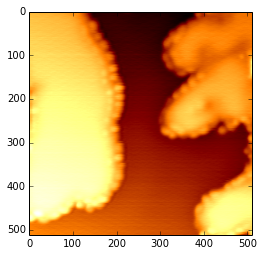

In [48]:
plt.imshow(test,cmap=cm)

In [30]:
new = test.astype('uint8')
img = Image.fromarray(new)

In [61]:
plt.imsave('test.png',test,cmap=cm)

In [33]:
img.save('test.png',cmap=cm)

In [44]:
new = np.zeros((512+40,512))
new[:,:] = 255
new[:512,:512] = test
new = new.astype('uint8')

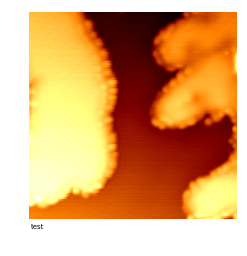

In [66]:
plt.imshow(new,cmap = cm)
plt.text(5,512+25,'test',fontsize=7)
plt.axis('off')
plt.savefig('test.png',cmap='gray')

In [64]:
plt.imsave('test.png',new,cmap=cm)